In [1]:
Threads.nthreads()

10

In [2]:
using
    Revise,
    QuantumStates,            # for calculating molecular structure
    OpticalBlochEquations,    # for solving optical Bloch equations
    BeamPropagation,          # for solving trajectories of molecules based on force profiles
    UnitsToValue,
    Statistics,
    Plots,
    DifferentialEquations,
    StaticArrays,
    RectiGrids
;

In [3]:
# A few constants used for the simulation
const λ = 688e-9
const Γ = 2π * 7 * 1e6 # see Ivan thesis, max rate is 2π*7MHz and there is a 2/(2+6) factor
                   # but the real scattering rate should be measured in experiment
const m = @with_unit 105 "u"
const k = 2π / λ

9.13253678369126e6

### Create an interpolation function for the force

Load the force v.s. velocity

In [4]:
using DataFrames
using CSV

saving_folder_path = ""

situation = "I=0mW, detuning_p=0.0MHz"
input = string(saving_folder_path,situation)

df = DataFrame(CSV.File(input));

In [5]:
df.Fz_mean = df.Fz_mean*0.35;

We will use a simple linear interpolation for our grid.

In [6]:
using Interpolations
using RectiGrids

In [7]:
vs = -50:1:200 # in the unit of m/s since I already added ./ (Γ / k) before

di = 0 # grid of position
rs = vcat([(n1/(di+1), n2/(di+1), n3/(di+1)) .* 2π for n1 ∈ 0:di, n2 ∈ 0:di, n3 ∈ 0:di]...)

scan_values = (r = rs, v = vs)
scan_values_grid = RectiGrids.grid(scan_values);

In [8]:
nodes = (scan_values_grid.v,)
itp_force = interpolate(nodes, reshape(df.Fz_mean, [length(node) for node ∈ nodes]...), Gridded(Linear()))
itp_Ne = interpolate(nodes, reshape(df.Ne_mean, [length(node) for node ∈ nodes]...), Gridded(Linear()))
;

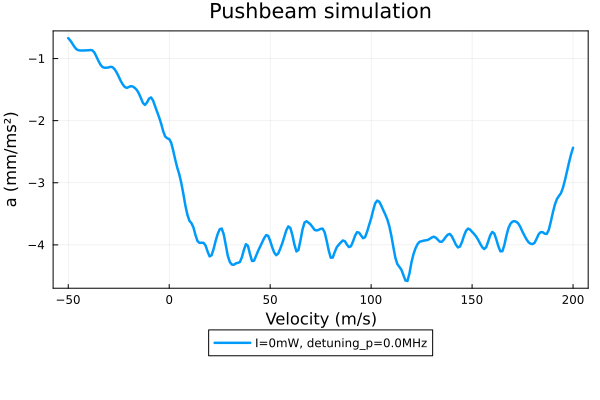

In [9]:
plot(scan_values_grid.v, itp_force.coefs/1e3,
    xlabel="Velocity (m/s)",
    ylabel="a (mm/ms²)",
    label = situation,
    framestyle=:box,
    linewidth=2.5,
    title = string("Pushbeam simulation") 
    )
plot!(legend=:outerbottom)

### Trajectory simulation

In [10]:
using 
    BeamPropagation,
    Distributions,
    StructArrays,
    MutableNamedTuples

# Create a few functions to perform random sampling of position and direction
using Distributions
uniform_dist = Uniform(0, 2π)
function sample_direction(r=1.0)
    θ = 2π * rand()
    z = rand() * 2 - 1
    return (r * sqrt(1 - z^2) * cos(θ), r * sqrt(1 - z^2) * sin(θ), r * z)
end
;

In [11]:
# Parameters for the trajectory simulation
n_molecules = 100000
total_time = @with_unit 28 "ms"
save_every = 2000
delete_every = 10
dt_min = 1e-10
dt_max = 1e-4
abstol = 1e-5
dt = 1e-8
max_steps = Int64(ceil(total_time / dt))
alg = "rkf12"
use_adaptive = false
times = (0:dt:max_steps * dt)[1:save_every:end-1]
;

In [12]:
# Define the gradient for our simulation
const gradB = 10 / 1e-2 # 10 G/cm
;

In [13]:
const MOT_distance = 1.5 # m 
const MOT_dx = 0.01 # m, beam size is 1cm
const MOT_dy = 0.01
const MOT_dz = 0.01
const cap_v = 10 # m/s
;

In [14]:
"""
    1-3: r
    4-6: v
"""
function f(du, u, p, t)
    f = SVector(0, 0, p.itp_force(u[6]))
    for i ∈ 1:3
        du[i] = u[3+i]
        du[3+i] = f[i]
    end

    # scattering_rate = Γ * p.itp_Ne(v[3])
    # if rand() < dt * scattering_rate
    #     particles.v[i] += SVector(sample_direction(ħ * k / m))
    # end
    
    return nothing
end
;

In [15]:
using BenchmarkTools

In [16]:
function condition(u, t, integrator)
    return (abs(u[1]) > 2MOT_dx || abs(u[2]) > 2MOT_dy || (u[6] < -30))
end
function affect!(integrator)
    terminate!(integrator)
end
cb = DiscreteCallback(condition, affect!)
;

In [17]:
p = (itp_force=itp_force,)
;

In [18]:
t_span = (0, total_time)
u0 = [0.,0,0,0,0,100]
prob = ODEProblem(f, u0, t_span, p)
@time sol = solve(prob, alg=DP5(), save_on=false, dense=false)#, callback=cb)
;

  2.833361 seconds (3.27 M allocations: 210.296 MiB, 4.52% gc time, 99.99% compilation time)


In [19]:
const r_dist = (Normal(0., 0.), Normal(0., 0.), Normal(0., 0.1))
const v_dist = (Normal(0., 3.), Normal(0., 3.), Normal(110., 10.))

function prob_func(prob, i, repeat)
    prob.u0[1] = rand(r_dist[1])
    prob.u0[2] = rand(r_dist[2])
    prob.u0[3] = rand(r_dist[3])
    prob.u0[4] = rand(v_dist[1])
    prob.u0[5] = rand(v_dist[2])
    prob.u0[6] = rand(v_dist[3])
    return prob
end
;

In [20]:
cb_copy = deepcopy(cb)
prob_copy = deepcopy(prob)

n_molecules = 100000
sols = Array{ODESolution}(undef, n_molecules)

@time @Threads.threads for i ∈ 1:n_molecules
    cb_copy = deepcopy(cb)
    prob_copy = deepcopy(prob)
    prob_copy = prob_func(prob_copy, i, false)
    sol = solve(prob_copy, alg=DP5(), callback=cb_copy, dense=false, reltol=1e-4)
    sols[i] = sol
    if (i % 1000) == 0
        GC.gc()
    end
    # println(i)
end 

times = [sol.t for sol ∈ sols]
trajectories = [[u[1:3] for u ∈ sol.u] for sol ∈ sols]
velocities = [[u[4:6] for u ∈ sol.u] for sol ∈ sols]
;

 44.341003 seconds (9.84 M allocations: 1.211 GiB, 95.99% gc time, 32.00% compilation time)


In [396]:
# ensemble_prob = EnsembleProblem(prob, prob_func=prob_func)
# @time ensemble_sol = solve(ensemble_prob, EnsembleThreads(), trajectories=n_molecules, callback=cb, dense=false)

# # Compute statistics
# times = [sol.t for sol ∈ ensemble_sol]
# trajectories = [[u[1:3] for u ∈ sol.u] for sol ∈ ensemble_sol]
# velocities = [[u[4:6] for u ∈ sol.u] for sol ∈ ensemble_sol]
# ;

In [397]:
n_captured = 0
for i ∈ 1:n_molecules
    n_captured += captured_by_MOT(trajectories[i], velocities[i])
end

In [398]:
function captured_by_MOT(trajectory, velocities)
    captured = false
    for i ∈ eachindex(trajectory)
        r = trajectory[i]
        v = velocities[i]
        if abs(r[1]) <= MOT_dx && abs(r[2]) <= MOT_dy && abs(r[3] - MOT_distance) <= MOT_dz && sqrt(sum(v.^2)) <= cap_v
            captured = true
        end
    end
    return captured
end
;

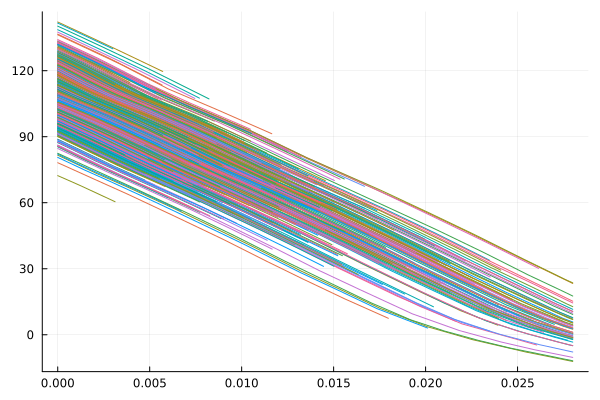

In [399]:
plot()
for i ∈ 1:1000:n_molecules
    plot!(times[i], [v[3] for v ∈ velocities[i]])
end
plot!(legend=nothing)

### How many will be captured by MOT?

In [17]:
MOT_distance = 1.5 # m 
MOT_dx = 0.01 # m, beam size is 1cm
MOT_dy = 0.01
MOT_dz = 0.01
cap_v = 10 # m/s

number_be_cap = 0
vz_end_cap_by_MOT = []
for i ∈ 1:n_molecules
    cap_by_MOT = false
    x = [x[1] for x ∈ s.trajectories[i]]
    y = [x[2] for x ∈ s.trajectories[i]]
    z = [x[3] for x ∈ s.trajectories[i]]
    vx = [x[1] for x ∈ s.velocities[i]]
    vy = [x[2] for x ∈ s.velocities[i]]
    vz = [x[3] for x ∈ s.velocities[i]]
    v = sqrt.(vx.*vx .+ vy.*vy + vz.*vz)

    for (j,_) ∈ enumerate(z)
        if (v[j] < cap_v) & (abs(x[j])<MOT_dx/2) & (abs(y[j])<MOT_dy/2) & (abs(z[j]-MOT_distance)<MOT_dz/2)
            cap_by_MOT = true
        end
    end

    if cap_by_MOT == true
        number_be_cap = number_be_cap + 1
        
    end
end

println("The number of captured molecule is ", number_be_cap, ", about ", (number_be_cap/n_molecules)*100, "%")

The number of captured molecule is 5, about 0.005%


Plot the trajectory and analysis

In [18]:
p1 = plot()
for i ∈ 1:n_molecules
    plot!(times[1:length(s.trajectories[i])] .* 1e3, [x[3] for x ∈ s.trajectories[i]] .* 1e3)
end
plot!(
    # ylim=(-2, 2),
    title="Molecule trajectories",
    xlabel="Time (ms)",
    ylabel="z position (mm)",
    legend=nothing
    )

p2 = plot()
for i ∈ 1:n_molecules
    plot!(times[1:length(s.trajectories[i])] .* 1e3, [x[3] for x ∈ s.velocities[i]])
end
plot!(
    title="Molecule velocities",
    xlabel="Time (ms)",
    ylabel="z velocity (m/s)",
    legend=nothing
    )

p3 = plot()
for i ∈ 1:n_molecules
    plot!(times[1:length(s.trajectories[i])] .* 1e3, [x[2] for x ∈ s.trajectories[i]] .* 1e3)
end
plot!(
    # ylim=(-2, 2),
    title="Molecule trajectories",
    xlabel="Time (ms)",
    ylabel="y position (mm)",
    legend=nothing
    )

p4 = plot()
for i ∈ 1:n_molecules
    plot!(times[1:length(s.trajectories[i])] .* 1e3, [x[2] for x ∈ s.velocities[i]])
end
plot!(
    title="Molecule velocities",
    xlabel="Time (ms)",
    ylabel="y velocity (m/s)",
    legend=nothing
    );
plot(p1,p2,p3,p4, layout = (2,2))

In [19]:
for MOT_distance in 1.4:0.01:1.8 # m 
    MOT_dx = 0.01 # m, beam size is 1cm
    MOT_dy = 0.01
    MOT_dz = 0.01
    cap_v = 15 # m/s

    number_be_cap = 0
    for i ∈ 1:n_molecules
        cap_by_MOT = false
        x = [x[1] for x ∈ s.trajectories[i]]
        y = [x[2] for x ∈ s.trajectories[i]]
        z = [x[3] for x ∈ s.trajectories[i]]
        vx = [x[1] for x ∈ s.velocities[i]]
        vy = [x[2] for x ∈ s.velocities[i]]
        vz = [x[3] for x ∈ s.velocities[i]]
        v = sqrt.(vx.*vx .+ vy.*vy + vz.*vz)

        for (j,_) ∈ enumerate(z)
            if (v[j] < cap_v) & (abs(x[j])<MOT_dx/2) & (abs(y[j])<MOT_dy/2) & (abs(z[j]-MOT_distance)<MOT_dz/2)
                cap_by_MOT = true
            end
        end

        if cap_by_MOT == true
            number_be_cap = number_be_cap + 1
        end
    end
    
    println("The MOT distance is ", MOT_distance)
    println("The number of captured molecule is ", number_be_cap, ", about ", (number_be_cap/n_molecules)*100, "%")
end

The MOT distance is 1.4
The number of captured molecule is 6, about 0.006%
The MOT distance is 1.41
The number of captured molecule is 3, about 0.003%
The MOT distance is 1.42
The number of captured molecule is 4, about 0.004%
The MOT distance is 1.43
The number of captured molecule is 7, about 0.006999999999999999%
The MOT distance is 1.44
The number of captured molecule is 10, about 0.01%
The MOT distance is 1.45
The number of captured molecule is 7, about 0.006999999999999999%
The MOT distance is 1.46
The number of captured molecule is 6, about 0.006%
The MOT distance is 1.47
The number of captured molecule is 3, about 0.003%
The MOT distance is 1.48
The number of captured molecule is 5, about 0.005%
The MOT distance is 1.49
The number of captured molecule is 6, about 0.006%
The MOT distance is 1.5
The number of captured molecule is 5, about 0.005%
The MOT distance is 1.51
The number of captured molecule is 4, about 0.004%
The MOT distance is 1.52
The number of captured molecule is 

### Histogram about velocity distribution

In [20]:
z_end_list = []
vz_end_list = []
vz_begin_list = []
for i ∈ 1:n_molecules
    x = [x[1] for x ∈ s.trajectories[i]]
    y = [x[2] for x ∈ s.trajectories[i]]
    z = [x[3] for x ∈ s.trajectories[i]]
    vx = [x[1] for x ∈ s.velocities[i]]
    vy = [x[2] for x ∈ s.velocities[i]]
    vz = [x[3] for x ∈ s.velocities[i]]
    v = sqrt.(vx.*vx .+ vy.*vy + vz.*vz)
    
    z_end = z[end]
    vz_end = vz[end]
    vz_begin = vz[1]
    
    append!(z_end_list,z_end)
    append!(vz_end_list,vz_end)
    append!(vz_begin_list,vz_begin)
end

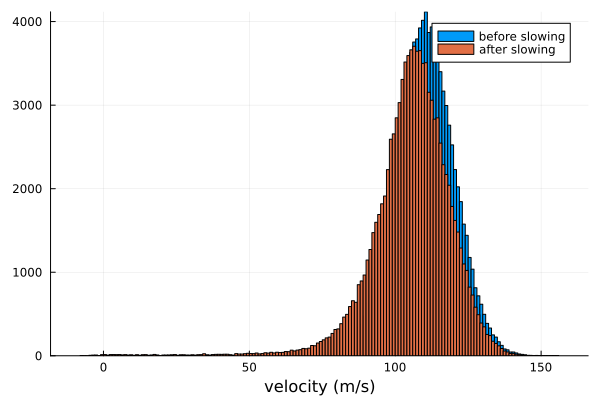

In [21]:
histogram(vz_begin_list, label="before slowing")
histogram!(vz_end_list, label="after slowing")
xlabel!("velocity (m/s)")